# Welcome!

 Welcome to our notebook on explainabilty in object detection. The object detection models used in this notebook are
 versions of the Yolov8 Object Detection Model (ODM). Yolo (= You Only Look Once) is a widespread architecture form of ODMs and is 
 continously developed and improved, which is why explainability for it can be regarded as highly relevant in this context.

 We specifically focused on the explainability of **Weapon related data** with the ODM. Our context scenario being that certain content in social media is banned and moderated by autmatic tools, like ODMs. With the upcoming of certain regulations like the Digital Service Act in the EU, companies have to increase the transparency in why these tools do what they do - why the content is removed. This is where our Proof-of-Concept comes in and provides a possible explenation to users on why there content / images was removed, if a social media platform was to moderate weapon specific data. Furthermore, a future research direction could explore this more into the direction of (realtime) security monitoring to identify weapons in store robberies or similar scenarios. 


 The 3 Versions of YoloV8 we are using to make comparisons on the explainability are:
 1. A Base Model trained on the Coco dataset. Basically a model that detects many "usual" objects e.g. person, cat, table etc, but not weapon specific objects.

 2. A Pre-Trained Model on Weapon data that we found: https://github.com/JoaoAssalim/Weapons-and-Knives-Detector-with-YOLOv8 . Specifically this model only has 2 classes. Guns or Knives. Also be aware that this model is ONLY able to identify those two objects and not the objects from the Coco dataset of "usual" objects.

 3. A Self-Trained Model that we trained ourselves with data from https://github.com/ari-dasci/OD-WeaponDetection/tree/master . Consisting of 6 Classes. 1 Pistols, 2 Knifes, 3 Smartphones, 4 Money Bills, 5 Purses and 6 Credit Cards / Tickets. The reason behind the distinction in these specific classes is that the objects 3,4,5,6 are very similarly handled by people as Guns and Knifes. Both are handeld objects where your hand and fingers make similar movments and postures. Hence an ODM is very likely to mix them up and it is hard to train them to distinguish all those objects effectively. 

 Below find a quick comparison of the precisions of the Pre_trained Model vs our Self-Trained Model.
 As we can see the pre trained model performs much better than our self trained model in terms of precision, but as said, only has to detect 2 class objects, while ours has to distinguis between 6 classes, which is very likely the reason for our self trained bad precision. 

<img src="models/pre_trained_performance.png" alt="Pre Trained" style="height: 600px; width:900px;"/>
<img src="models/self_trained_performance.png" alt="Self Trained" style="height: 600px; width:900px;"/>


 

 ## Notebook Structure:
 This notebook is a summarization of our efforts and has the following structure:

 * Loading the relevant models
 * Setting Up the Content Moderation Functions
 * A simple GUI Interface to run 
 * Some examples and comparisons of pictures, the Object detection process and the explainability behind it
 

# Imports

In [1]:
import ultralytics
import tkinter as tk
import os
from tkinter import filedialog, Label, Button
from PIL import Image, ImageTk
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt
from tqdm import tqdm


# Models

In [2]:
from ultralytics import YOLO
# base model
model_v8_base = YOLO('models/yolov8_base_weights.pt')
model_v8_base_path = 'models/yolov8_base_weights.pt'

#fine tuned
model_v8_fine = YOLO('models/yolov8_pre_trained.pt')
model_v8_fine_path = 'models/yolov8_pre_trained.pt'

# oure fine tuned model
model_v8_self_fine = YOLO('models/yolov8_self_trained.pt')
model_v8_self_fine_path = 'models/yolov8_self_trained.pt'

# Architecture:


## Forbidden Classes
Defines the list of forbidden classes (e.g., "guns", "knife") that the content moderation system will flag.

In [3]:
# define what elements are forbidden (has to conform to the classes in the weapon fine tuned model)
forbidden_classes = ["guns", "knife"]

## detect_objects

Detects objects in an image using a specified model and returns the detected image and class names.

In [4]:
def detect_objects(model, image):
    results = model.predict(image,conf=0.2)
    detected_img = results[0].plot()
    #print(results[0])

    # Extract the predicted boxes
    boxes = results[0].boxes

    # save class names from prediction boxes
    class_names = []
    if boxes is not None:
        # Iterate through the detected boxes
        for box in boxes:
            cls_id = int(box.cls)  # Class ID
            conf = float(box.conf)  # Confidence score
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())  # Bounding box coordinates

            # Get the class name from the class ID
            class_name = results[0].names[cls_id]
            class_names.append(class_name)

            print(f"Class: {class_name}, Confidence: {conf:.2f}, Box: ({x1}, {y1}, {x2}, {y2})")



    # show with matplotlib
    #plt.imshow(cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB))
    #plt.axis('off')
    #plt.show()

    return detected_img, class_names


## Generate_explanation

Generates visual explanations for detected objects using different Grad-CAM methods and returns a list of explanation images.

In [5]:
from YOLOv8_Explainer import yolov8_heatmap, display_images

def generate_explanation(model_path, image_path):


  model_egc = yolov8_heatmap(
      weight= model_path,
      conf_threshold=0.4,
      method = "EigenGradCAM",
      layer=[10, 12, 14, 16, 18, -3],
      ratio=0.02,
      show_box=True,
      renormalize=False
  )

  model_pp = yolov8_heatmap(
      weight= model_path,
      conf_threshold=0.4,
      method = "GradCAMPlusPlus",
      layer=[10, 12, 14, 16, 18, -3],
      ratio=0.02,
      show_box=True,
      renormalize=False
  )

  model_lc = yolov8_heatmap(
      weight= model_path,
      conf_threshold=0.4,
      method = "LayerCAM",
      layer=[10, 12, 14, 16, 18, -3],
      ratio=0.02,
      show_box=True,
      renormalize=False
  )

  # set img path
  input_img_path = image_path


  # set img list
  imagelist = model_egc(img_path = image_path)

  return imagelist


c:\Users\Timo\.pyenv\pyenv-win\versions\3.12.2\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Notification Message
Sends a notification to the uploader with a message and an explanation image (placeholder function).

In [6]:
def notify_uploader(image, explanation_image, message):
    # Send a notification with the message and explanation image
    # This can be done via email, messaging service, etc.
    # Placeholder function#
    message = "We are sorry to inform you that some content of your image does not comply with our terms and regulations. /n Our Detection Model detected forbidden items in your picture, attached is an explenation why your content is likely to be on our forbidden items list. If you feel this is a mistake you can contact us here..."
    print(message)
    #explanation_image.show()

## Process Image
Processes an image to detect forbidden objects, generates explanations if needed, and returns the results along with a message. Basically it combines all the above functions to actual produce an output.

The logic behind it may be interesting to explain. Since our Weapon specific models (both Pre and Self Trained) only have either 2 / 6 classes which are focused on weapon or weapon similar objects, none of these 2 models can detect the "usual" objects from the coco dataset (objects like people, tables, cars etc). Therefore the logic behind this function is processing the image both with the Weapon Specific model and with the Base-Model (the usual obejcts model). 

The weapon model processes the image first, and if it detects a weapon (with a certain adjustable confidence threshold, in our case the very low 40%), it immediately returns the image, with an explenation and a message. If on the other hand it does NOT detect any weapon specific object, it passes the image to the Base-Model, which then identifies the "usual" objects in the picture. 

In [7]:
def process_image(image_path, forbidden_classes, fine_tuned_model, original_model, fine_tuned_model_path, original_model_path):

    # Load image
    image = Image.open(image_path)
    #image_np = np.array(image)

    # Detect objects using the fine-tuned model
    fine_tuned_img, class_names = detect_objects(fine_tuned_model, image)
    # Check for forbidden objects
    is_any_item_forbidden = any(item in forbidden_classes for item in class_names)
    if is_any_item_forbidden == True:
        # Generate explanation using GradCam
                explanation_image = generate_explanation(fine_tuned_model_path, image_path)
                if explanation_image[0] == None:
                    message = f"Sorry, we were unable to generate an explenation for this Image. Please provide another picture."
                #print(explanation_image)


                # Notify uploader
                message = f"The image was restricted because it contains a forbidden object: {class_names}"
                notify_uploader(image, explanation_image, message)

                # Restrict the image (e.g., move to a restricted folder, delete, etc.)
                #restrict_image(image_path)

                return fine_tuned_img, explanation_image, message


                
    else:
        # Optionally, process with the original model for additional moderation
        results_original, class_names = detect_objects(original_model, image)
        if class_names is not None:
            explanation_image = generate_explanation(original_model_path, image_path)
            if explanation_image[0] == None:
                message = f"Sorry, we were unable to generate an explenation for this Image. Please provide another picture."
            else:
                message = f"Thank you your picture is good to go!"
        else:
            message = f"Sorry, we were unable to detect any objects in the image. Please provide another picture."
        
        # Further logic can be added here 
        #print(results_original, explanation_image)

    return results_original, explanation_image, message

## Run 
Run the Process Image function as an example and to see if it works.

Be aware that even tho this runs and predictions are made, you dont see the image yet. This is due to the fact that this loop is also used by the prototype GUI and that needs to be passed the arrays rather than the display of the image and explanation files. Thats why you dont see it yet.

In [8]:
img_path = "images/test_pistol.jpg"

In [9]:
img_path = "images/test_normal.jpg"

In [10]:
process_image(img_path,
              forbidden_classes,
              fine_tuned_model = model_v8_fine,
              original_model = model_v8_base,
              original_model_path = model_v8_base_path,
              fine_tuned_model_path = model_v8_fine_path
              )


0: 448x640 (no detections), 76.7ms
Speed: 3.3ms preprocess, 76.7ms inference, 7.2ms postprocess per image at shape (1, 3, 448, 640)

0: 448x640 1 person, 1 chair, 20.0ms
Speed: 2.0ms preprocess, 20.0ms inference, 35.0ms postprocess per image at shape (1, 3, 448, 640)
Class: person, Confidence: 0.96, Box: (492, 11, 1506, 1270)
Class: chair, Confidence: 0.85, Box: (118, 995, 474, 1275)
YOLOv8n summary: 225 layers, 3157200 parameters, 0 gradients, 8.9 GFLOPs
YOLOv8n summary: 225 layers, 3157200 parameters, 0 gradients, 8.9 GFLOPs
YOLOv8n summary: 225 layers, 3157200 parameters, 0 gradients, 8.9 GFLOPs


(array([[[255, 254, 244],
         [255, 254, 244],
         [255, 253, 245],
         ...,
         [130, 124, 117],
         [132, 126, 119],
         [133, 127, 120]],
 
        [[255, 254, 244],
         [255, 254, 244],
         [255, 253, 245],
         ...,
         [131, 125, 118],
         [131, 125, 118],
         [131, 125, 118]],
 
        [[255, 254, 244],
         [255, 254, 244],
         [255, 253, 245],
         ...,
         [132, 126, 119],
         [133, 127, 120],
         [134, 128, 121]],
 
        ...,
 
        [[ 86,  89,  87],
         [ 87,  90,  88],
         [ 87,  90,  88],
         ...,
         [145, 103,  84],
         [144, 101,  84],
         [144, 101,  84]],
 
        [[ 85,  90,  88],
         [ 86,  91,  89],
         [ 89,  92,  90],
         ...,
         [145, 104,  82],
         [148, 107,  85],
         [146, 105,  83]],
 
        [[ 86,  88,  88],
         [ 87,  89,  89],
         [ 88,  90,  90],
         ...,
         [147, 105,  86],
  

# GUI Setup


   Sets up a Tkinter-based GUI Proof of Concept for uploading and displaying images, processing them through the content moderation system, and showing the results and explanations. We also include a seperate app.py file, to run this from the command line. For the further evaluation of this very notebook just skip to the examples below and run the Prototype via cmd later.

In [11]:
import tkinter as tk
from tkinter import filedialog, Label, Button
from PIL import Image, ImageTk
import os
import cv2
from ultralytics import YOLO

# Function to upload and display the image
def upload_image():
    file_path = filedialog.askopenfilename()
    if file_path:
        original_img = Image.open(file_path)
        #original_img.thumbnail((400, 400))
        #original_img = ImageTk.PhotoImage(original_img)

        results_model, explanation_image, message = process_image(file_path,
                            forbidden_classes,
                            fine_tuned_model = model_v8_fine,
                            original_model = model_v8_base,
                            original_model_path = model_v8_base_path,
                            fine_tuned_model_path = model_v8_fine_path
                            )
    
        # Convert results_model to Image and then to ImageTk
        if isinstance(results_model, (list, tuple)):
            results_model = results_model[0]
        results_model_img = Image.fromarray(cv2.cvtColor(results_model, cv2.COLOR_BGR2RGB))
        results_model_img.thumbnail((800, 800))
        results_model_tk = ImageTk.PhotoImage(results_model_img)
        

        #process_image(file_path)
        print(explanation_image)
        if explanation_image[0] == None:
            processed_img = original_img
        else:
            processed_img = explanation_image[0]
        processed_img.thumbnail((800, 800))
        processed_img = ImageTk.PhotoImage(processed_img)

        panel_left.config(image=results_model_tk )
        panel_left.image = results_model_tk  # Keep a reference to prevent garbage collection
        panel_right.config(image=processed_img)
        panel_right.image = processed_img  # Keep a reference to prevent garbage collection

        message_label.config(text=message)

# Function to clear the current image and reset the interface
def clear_file():
    panel_left.config(image='')
    panel_left.image = None
    panel_right.config(image='')
    panel_right.image = None
    message_label.config(text='')

# Create the main window
root = tk.Tk()
root.title("xAIM Weapon Content Moderation")
root.geometry("900x600")  # Fixed size window
root.configure(bg='#2E2E2E')  # Dark background for modern look

# Add logo and title
logo = Image.open("images/logo.jpg")  # Update with your logo path
logo.thumbnail((100, 100))
logo_tk = ImageTk.PhotoImage(logo)  # Keep a reference to prevent garbage collection
logo_label = Label(root, image=logo_tk, bg='#2E2E2E')
logo_label.pack(pady=10)

title_label = Label(root, text="xAIM Weapon Content Moderation", font=("Helvetica", 24, "bold"), fg="#FFFFFF", bg='#2E2E2E')
title_label.pack(pady=10)

# Create and pack the widgets
frame = tk.Frame(root, bg='#2E2E2E')
frame.pack(pady=20)

panel_left = Label(frame, bg='#2E2E2E')
panel_left.grid(row=0, column=0, padx=20)

panel_right = Label(frame, bg='#2E2E2E')
panel_right.grid(row=0, column=1, padx=20)

message_label = Label(root, text="", font=("Helvetica", 14), fg="#FFFFFF", bg='#2E2E2E')
message_label.pack(pady=10)

btn_frame = tk.Frame(root, bg='#2E2E2E')
btn_frame.pack(pady=20)

btn_upload = Button(btn_frame, text="Upload an Image", command=upload_image, font=("Helvetica", 14), bg="#1E90FF", fg="#FFFFFF", activebackground="#104E8B", activeforeground="#FFFFFF")
btn_upload.grid(row=0, column=0, padx=10)

btn_clear = Button(btn_frame, text="Clear File", command=clear_file, font=("Helvetica", 14), bg="#FF6347", fg="#FFFFFF", activebackground="#CD5C5C", activeforeground="#FFFFFF")
btn_clear.grid(row=0, column=1, padx=10)

# Run the application
root.mainloop()



0: 384x640 1 guns, 66.6ms
Speed: 1.0ms preprocess, 66.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Class: guns, Confidence: 0.35, Box: (1379, 660, 1562, 878)
Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs
Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs
Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs
'int' object has no attribute 'backward'
We are sorry to inform you that some content of your image does not comply with our terms and regulations. /n Our Detection Model detected forbidden items in your picture, attached is an explenation why your content is likely to be on our forbidden items list. If you feel this is a mistake you can contact us here...
[None]

0: 384x640 (no detections), 5.5ms
Speed: 1.0ms preprocess, 5.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 22.0ms
Speed: 0.5ms preprocess, 22.0ms inference, 1.0ms postprocess per image at shap

# Example Usage:

Here Demonstrates the usage of the object detection and explanation generation functions on various example images.
The various examples always follow the same pattern. First we make the object detection with all 3 models. First the Base Model, then the PreTrained and then our Self-Trained Model. And then we generate the explenations for them.

Any interesting things will be pointed out with markdown notes at below the pictures.

## Picture 1

Another instance of the object detection function which also now Displays the images. 
Be aware the confidence is set very low to 0.2 on purpose, because many predictions are rather low and would not be seen otherwise.

In [12]:
def detect_objects_plot(model, image):
    results = model.predict(image,conf=0.2) 
    detected_img = results[0].plot()
    #print(results[0])

    # Extract the predicted boxes
    boxes = results[0].boxes

    # save class names from prediction boxes
    class_names = []
    if boxes is not None:
        # Iterate through the detected boxes
        for box in boxes:
            cls_id = int(box.cls)  # Class ID
            conf = float(box.conf)  # Confidence score
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())  # Bounding box coordinates

            # Get the class name from the class ID
            class_name = results[0].names[cls_id]
            class_names.append(class_name)

            print(f"Class: {class_name}, Confidence: {conf:.2f}, Box: ({x1}, {y1}, {x2}, {y2})")



    # show with matplotlib
    plt.figure(figsize=(12, 8))  # Increase the figure size
    plt.imshow(cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    return #detected_img, class_names



image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\pistol_0696.jpg: 448x640 1 person, 1 cell phone, 42.5ms
Speed: 1.5ms preprocess, 42.5ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Class: person, Confidence: 0.90, Box: (44, 50, 864, 673)
Class: cell phone, Confidence: 0.56, Box: (644, 243, 930, 343)


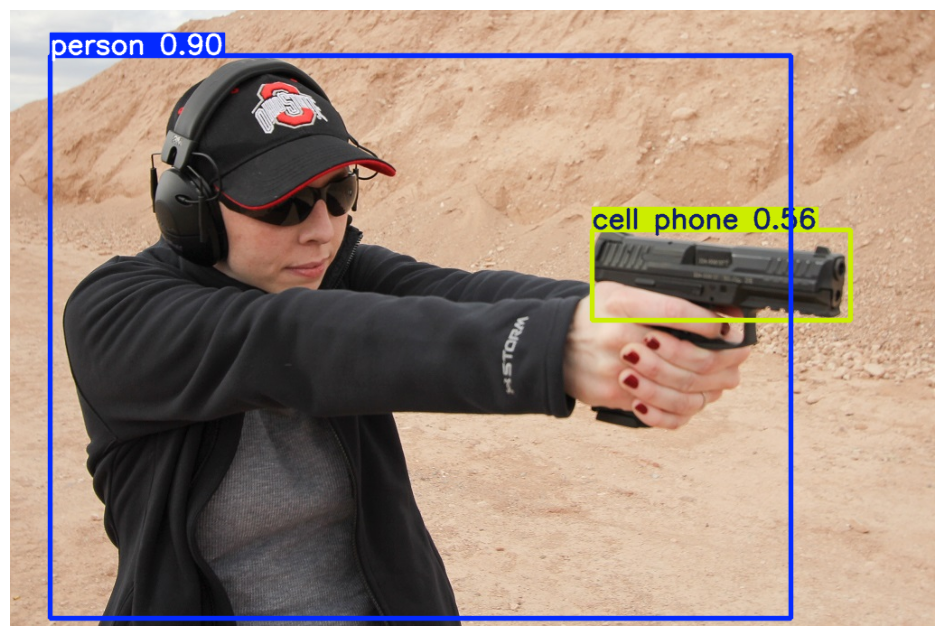

In [13]:
detect_objects_plot(model_v8_base, 'images/pistol_0696.jpg')


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\pistol_0696.jpg: 448x640 2 gunss, 5.5ms
Speed: 2.0ms preprocess, 5.5ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Class: guns, Confidence: 0.77, Box: (641, 239, 925, 462)
Class: guns, Confidence: 0.52, Box: (643, 242, 927, 373)


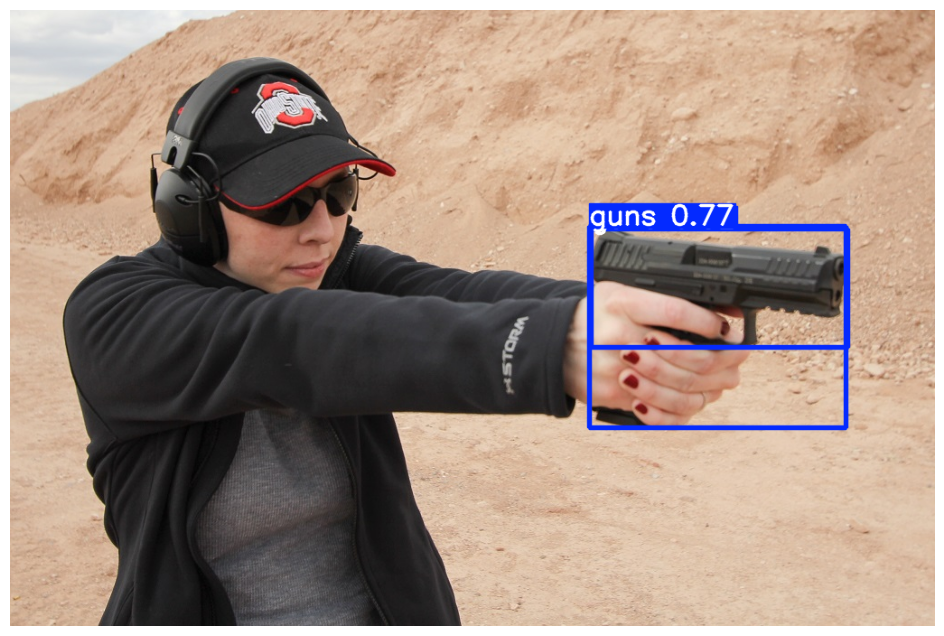

In [14]:
detect_objects_plot(model_v8_fine, 'images/pistol_0696.jpg')


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\pistol_0696.jpg: 448x640 2 billetes, 9.5ms
Speed: 1.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Class: billete, Confidence: 0.89, Box: (632, 239, 930, 467)
Class: billete, Confidence: 0.23, Box: (151, 49, 430, 289)


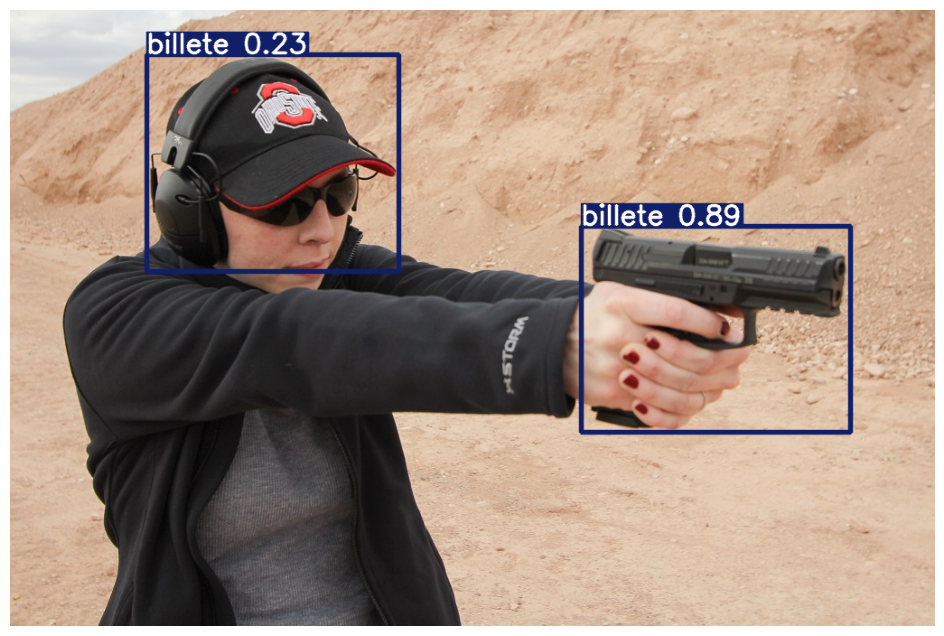

In [15]:
detect_objects_plot(model_v8_self_fine, 'images/pistol_0696.jpg')

Note how our Self-Trained Model, which has 6 classes detects the head of the person as a "billete" (= spanish for bill), and the same for the pistol, unfortunately. Also note tho that even tho the prediction of the Gun is ofcourse wrong, the actual object box is very accurate. This behavior can be seen in later examples as well. 

Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs


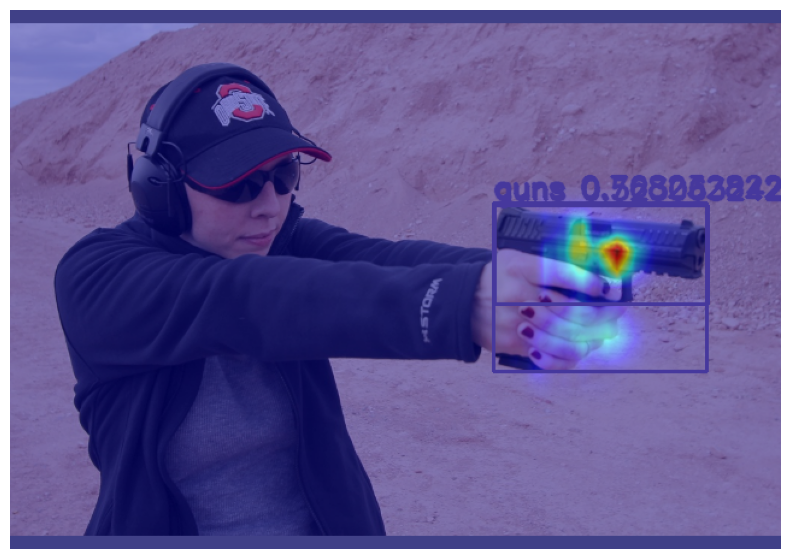

In [16]:
model_egc = yolov8_heatmap(
    weight= 'models/yolov8_pre_trained.pt',
    conf_threshold=0.4,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/pistol_0696.jpg'))

EigenGradCam Explanation of the Pre-Trained Model.

## Picture 2


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Hurling.jpg: 320x640 2 persons, 84.9ms
Speed: 1.0ms preprocess, 84.9ms inference, 2.2ms postprocess per image at shape (1, 3, 320, 640)
Class: person, Confidence: 0.81, Box: (53, 3, 1212, 639)
Class: person, Confidence: 0.69, Box: (730, 174, 1226, 639)


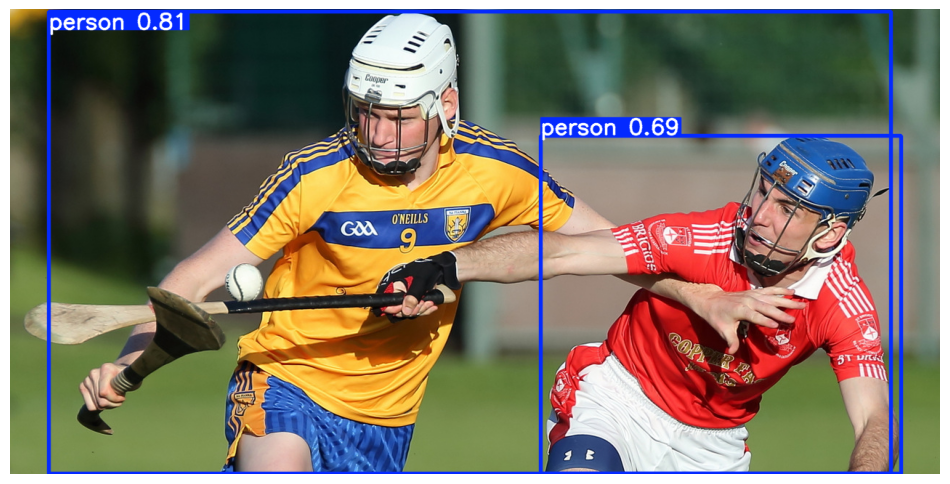

In [17]:
detect_objects_plot(model_v8_base, 'images/Hurling.jpg')


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Hurling.jpg: 320x640 1 guns, 15.8ms
Speed: 2.0ms preprocess, 15.8ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 640)
Class: guns, Confidence: 0.62, Box: (87, 452, 249, 588)


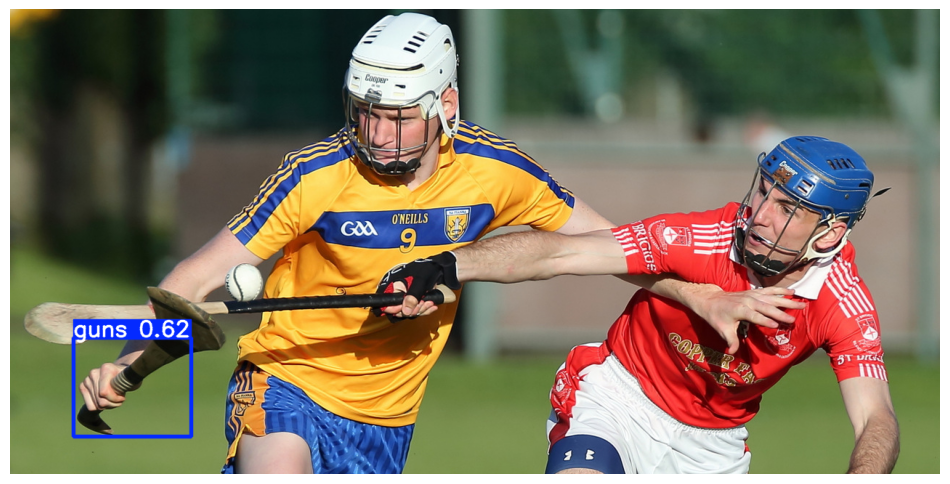

In [18]:
detect_objects_plot(model_v8_fine, 'images/Hurling.jpg')

Since the PRe-Trained Model only detects Gun or Knife, ofcourse it sees a knife here. But with rather low confidence of ~60%


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Hurling.jpg: 320x640 (no detections), 15.6ms
Speed: 1.0ms preprocess, 15.6ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 640)


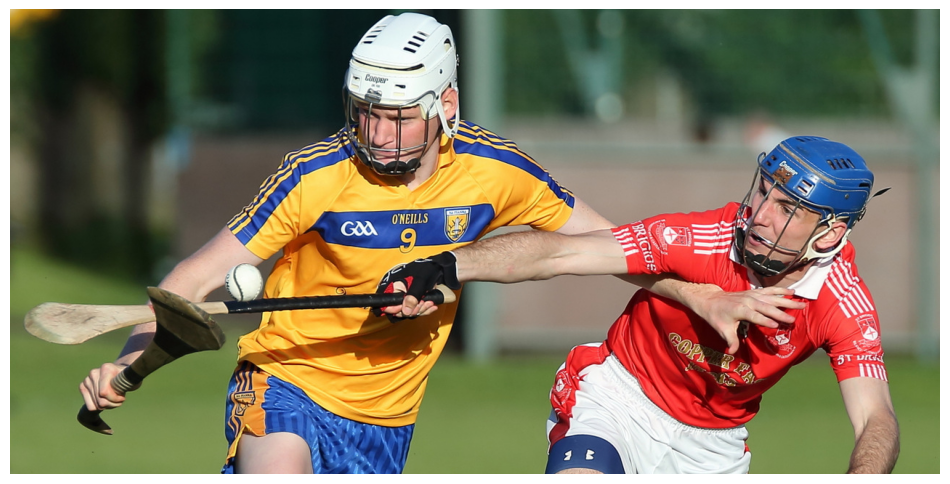

In [19]:
detect_objects_plot(model_v8_self_fine, 'images/Hurling.jpg')

Our Self-Trained model cannot detect anything here with a conf of over 20%

Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs


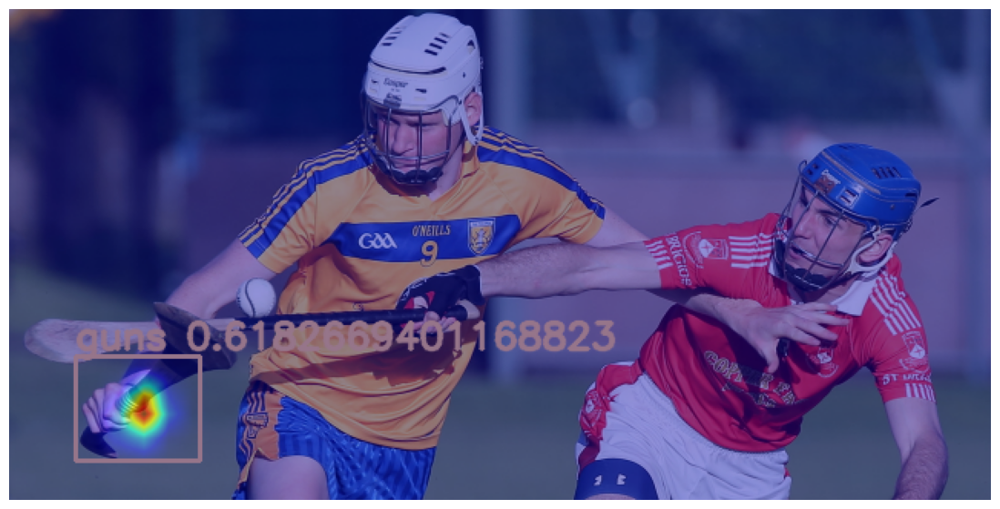

In [20]:
model_egc = yolov8_heatmap(
    weight= 'models/yolov8_pre_trained.pt',
    conf_threshold=0.4,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/Hurling.jpg'))

## Picture 3


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Pen.jpg: 448x640 6 persons, 3 ties, 48.9ms
Speed: 71.8ms preprocess, 48.9ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Class: person, Confidence: 0.93, Box: (519, 240, 943, 585)
Class: person, Confidence: 0.93, Box: (42, 180, 481, 577)
Class: person, Confidence: 0.90, Box: (0, 12, 165, 540)
Class: person, Confidence: 0.88, Box: (825, 107, 1023, 557)
Class: person, Confidence: 0.86, Box: (743, 20, 948, 384)
Class: tie, Confidence: 0.84, Box: (267, 360, 319, 513)
Class: tie, Confidence: 0.73, Box: (680, 408, 716, 553)
Class: tie, Confidence: 0.57, Box: (848, 236, 952, 465)
Class: person, Confidence: 0.28, Box: (998, 72, 1023, 243)


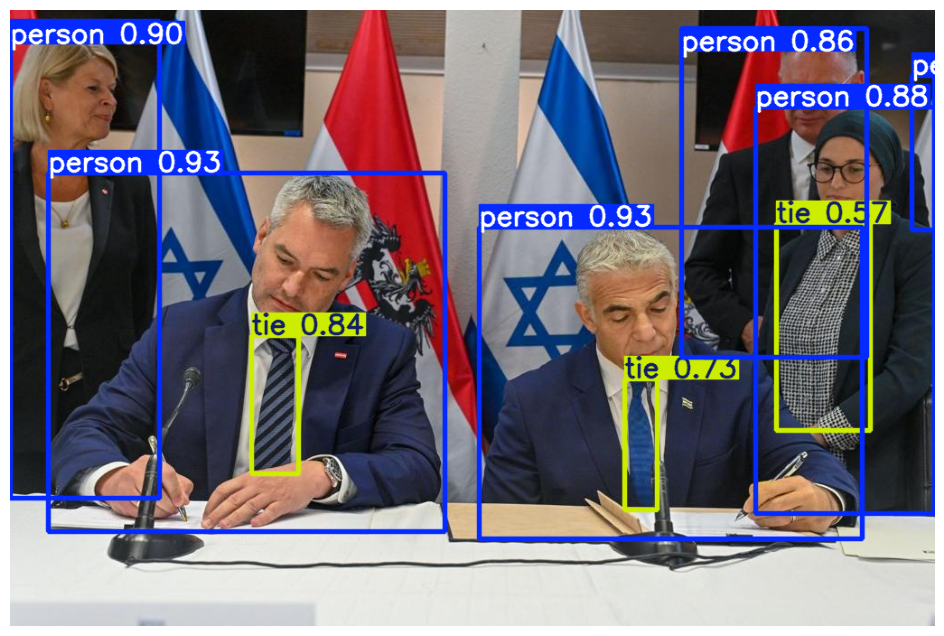

In [21]:
detect_objects_plot(model_v8_base, 'images/Pen.jpg')

Apperently the Coco dataset and base model is focused on Person and Ties. Flags and Microphones seem to be rather hard to detect. 


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Pen.jpg: 448x640 2 gunss, 13.1ms
Speed: 2.0ms preprocess, 13.1ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Class: guns, Confidence: 0.38, Box: (841, 487, 883, 522)
Class: guns, Confidence: 0.35, Box: (385, 237, 432, 307)


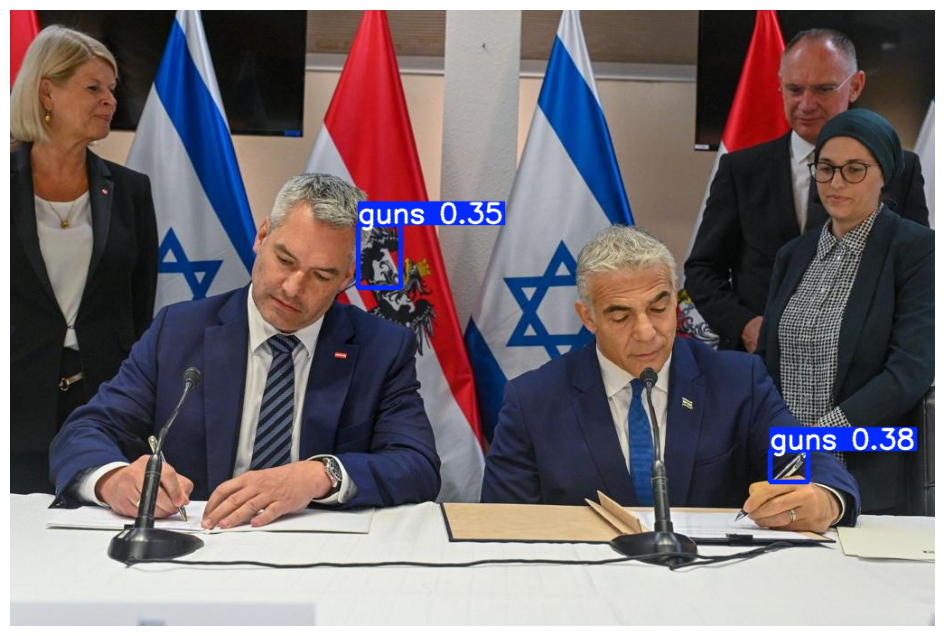

In [22]:
detect_objects_plot(model_v8_fine, 'images/Pen.jpg')

The Pre-Trained Model tries to find guns wherever it can, with a low confidence but completely out of place.


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\Pen.jpg: 448x640 1 smartphone, 12.0ms
Speed: 1.5ms preprocess, 12.0ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)
Class: smartphone, Confidence: 0.22, Box: (135, 392, 215, 556)


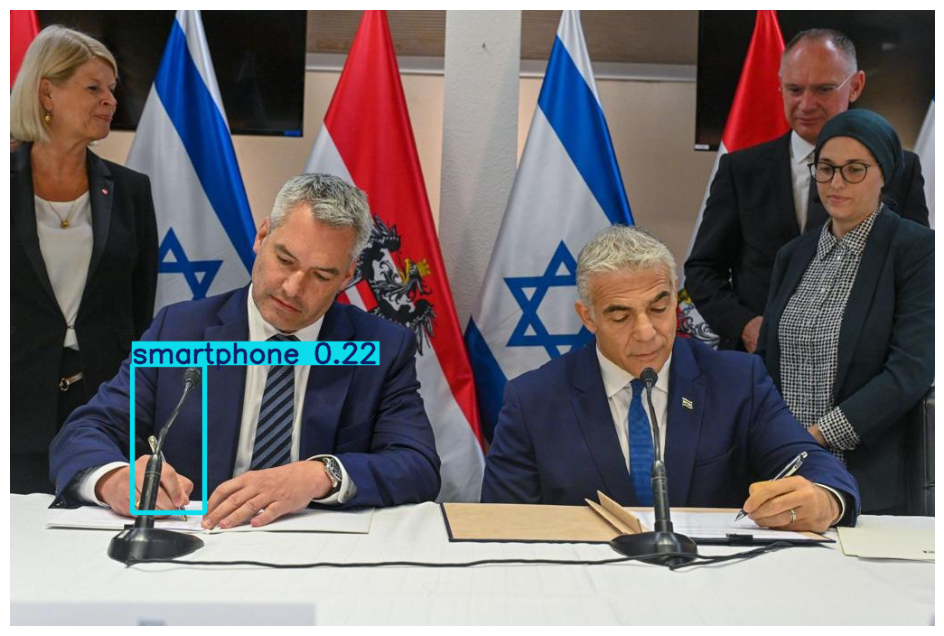

In [23]:
detect_objects_plot(model_v8_self_fine, 'images/Pen.jpg')

Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs


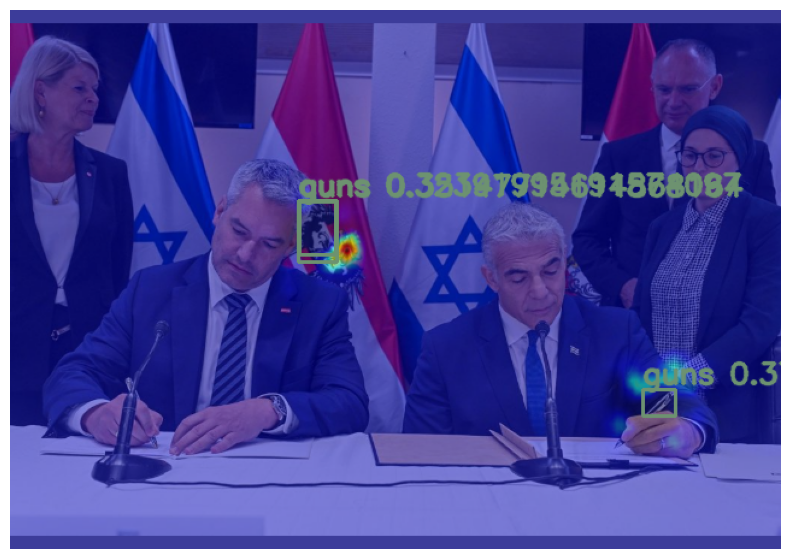

In [24]:
model_egc = yolov8_heatmap(
    weight= 'models/yolov8_pre_trained.pt',
    conf_threshold=0.3,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/Pen.jpg'))

## Picture 4


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\test_pistol.jpg: 544x640 1 person, 1 cell phone, 86.0ms
Speed: 8.5ms preprocess, 86.0ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)
Class: person, Confidence: 0.80, Box: (28, 20, 630, 563)
Class: cell phone, Confidence: 0.58, Box: (179, 155, 243, 220)


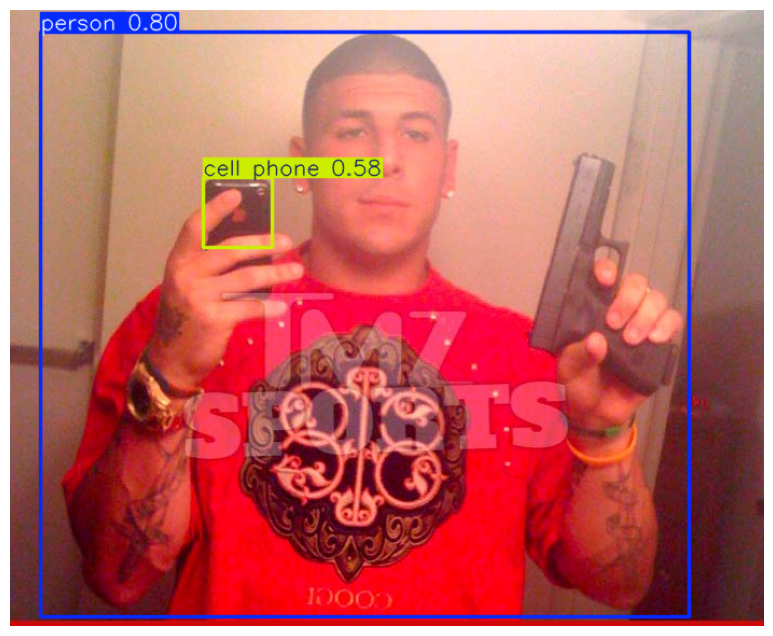

In [25]:
detect_objects_plot(model_v8_base, 'images/test_pistol.jpg')

Correct identification of the major elements from the base model. but ofcourse omitting the gun, since it was not trained on it.


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\test_pistol.jpg: 544x640 1 guns, 59.1ms
Speed: 5.0ms preprocess, 59.1ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)
Class: guns, Confidence: 0.80, Box: (474, 96, 617, 361)


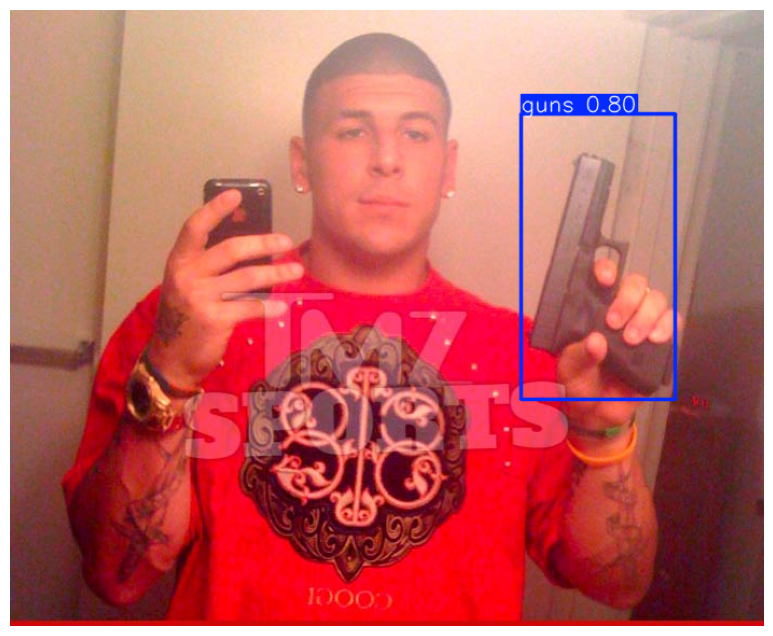

In [26]:
detect_objects_plot(model_v8_fine, 'images/test_pistol.jpg')


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\test_pistol.jpg: 544x640 1 billete, 1 tarjeta, 58.6ms
Speed: 4.0ms preprocess, 58.6ms inference, 2.5ms postprocess per image at shape (1, 3, 544, 640)
Class: billete, Confidence: 0.77, Box: (477, 129, 619, 339)
Class: tarjeta, Confidence: 0.49, Box: (176, 154, 244, 268)


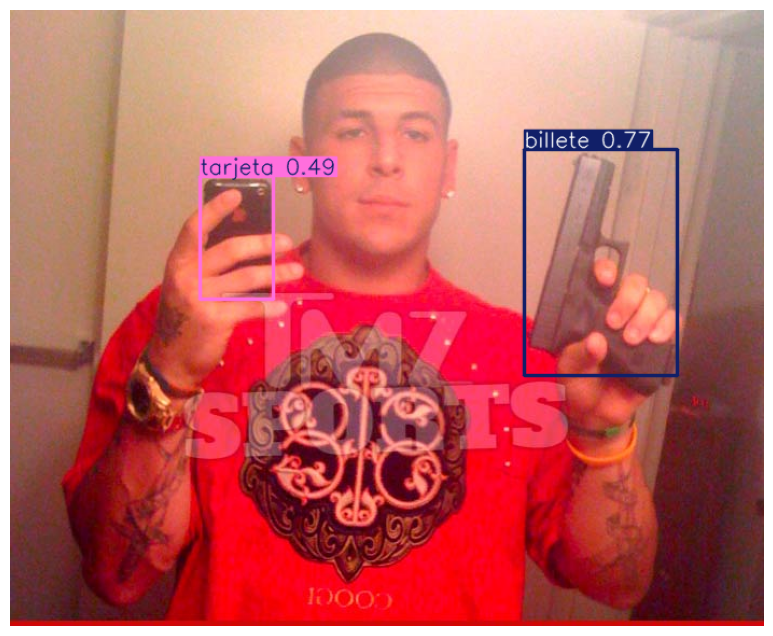

In [27]:
detect_objects_plot(model_v8_self_fine, 'images/test_pistol.jpg')

Self Trained Model again wrongly identifies the objects, but at least detects them in the right spaces. Again stressing that the model knows where to look, but that the differentiation between the 6 classes proves to be rather difficult for it. 

Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs


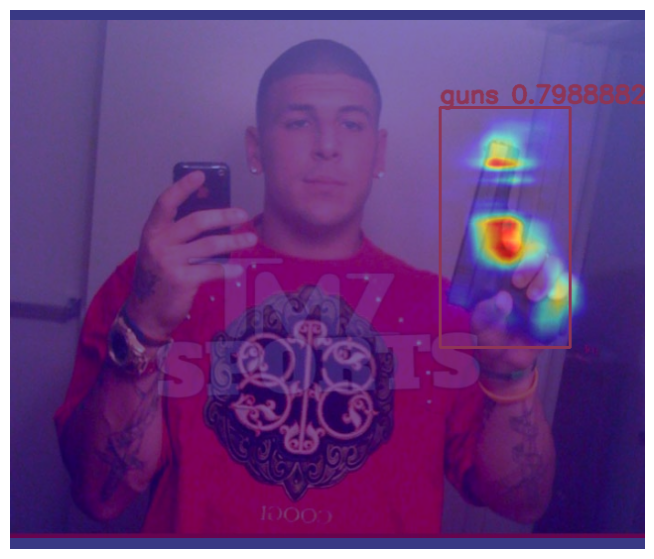

In [28]:
model_egc = yolov8_heatmap(
    weight= 'models/yolov8_pre_trained.pt',
    conf_threshold=0.4,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/test_pistol.jpg'))

Apperently the trigger and the finger on the trigger seem to be important for an identification as a gun.

## Robbery 1

Here the Pre-Trained Model is completely off. It detects a gun, but at the shelf on the right corner while our self-trained model detects a smartphone (instead of the gun), but is at least making the identification box in the right place.


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_1.png: 384x640 2 persons, 2 tvs, 21.5ms
Speed: 2.0ms preprocess, 21.5ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)
Class: person, Confidence: 0.82, Box: (522, 77, 1100, 613)
Class: person, Confidence: 0.80, Box: (0, 390, 322, 871)
Class: tv, Confidence: 0.76, Box: (74, 332, 261, 553)
Class: tv, Confidence: 0.57, Box: (373, 234, 654, 505)


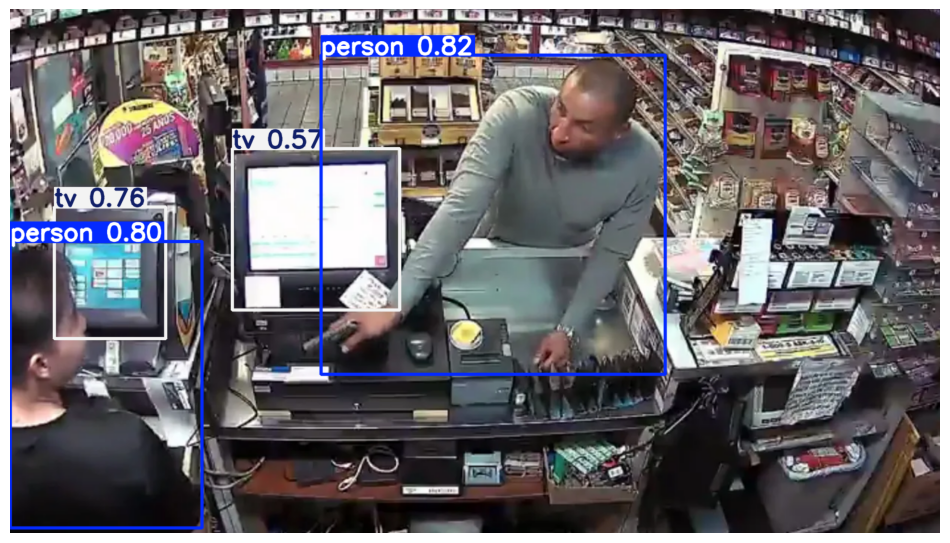


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_1.png: 384x640 1 guns, 17.1ms
Speed: 1.0ms preprocess, 17.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Class: guns, Confidence: 0.35, Box: (1379, 660, 1562, 878)


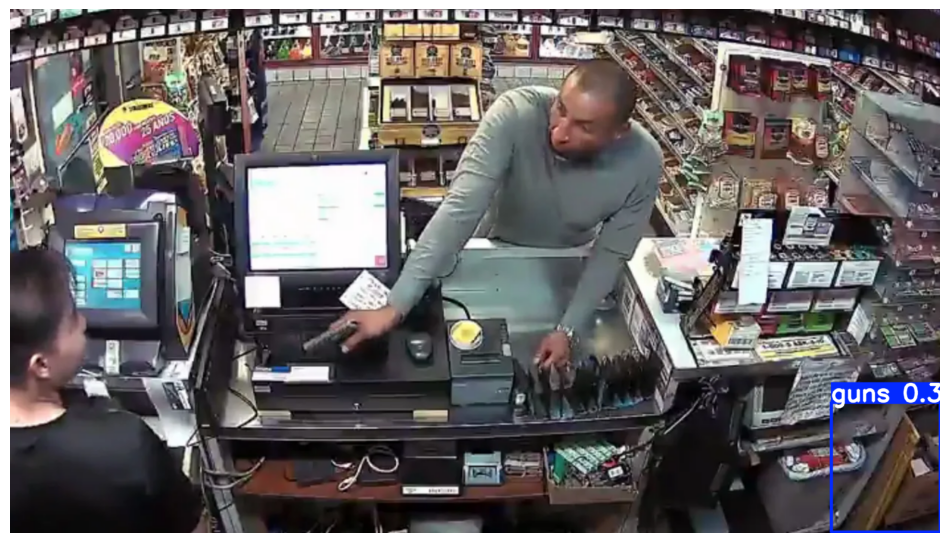


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_1.png: 384x640 1 smartphone, 23.0ms
Speed: 3.5ms preprocess, 23.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Class: smartphone, Confidence: 0.27, Box: (486, 494, 592, 580)


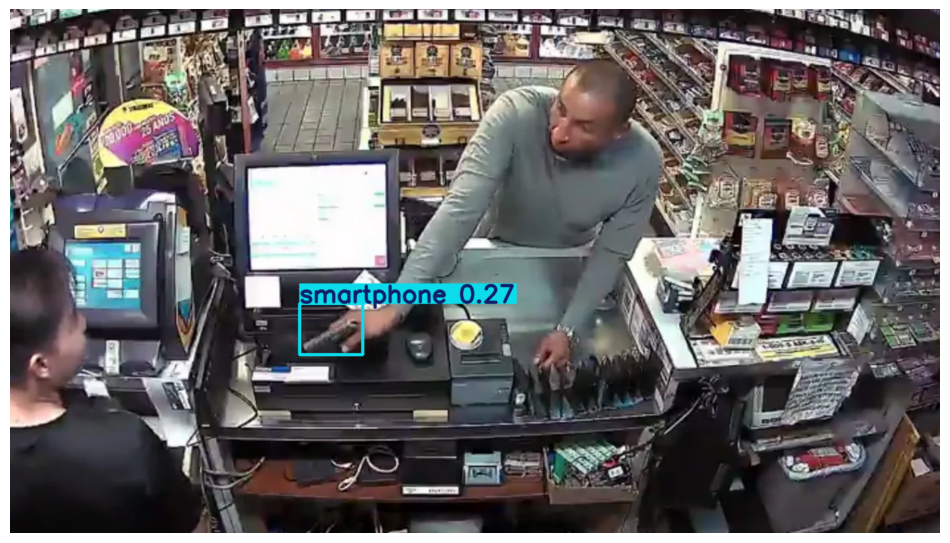

(None, None, None)

In [29]:
detect_objects_plot(model_v8_base, 'images/armed_robbery_1.png'), detect_objects_plot(model_v8_fine, 'images/armed_robbery_1.png'), detect_objects_plot(model_v8_self_fine, 'images/armed_robbery_1.png')

YOLOv8n summary: 225 layers, 3157200 parameters, 0 gradients, 8.9 GFLOPs


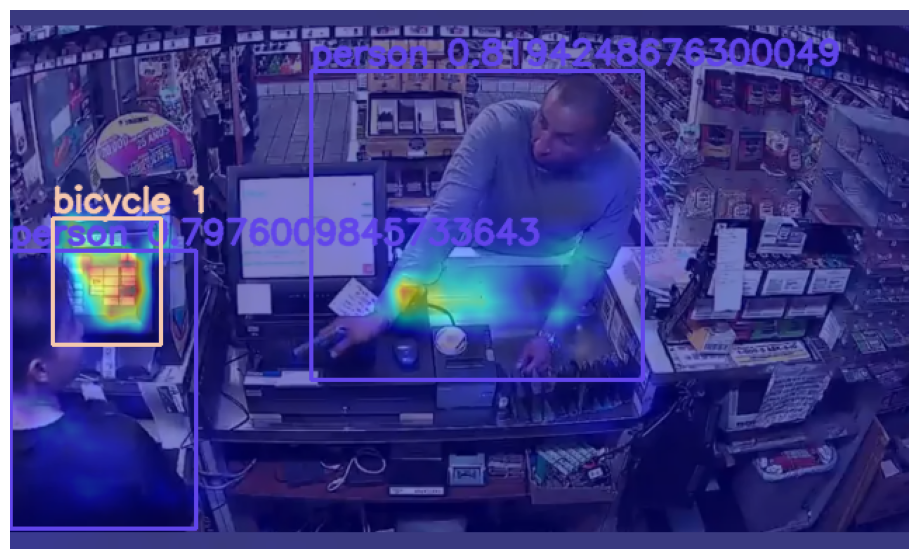

In [30]:
model_egc = yolov8_heatmap(
    weight= model_v8_base_path,
    conf_threshold=0.7,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/armed_robbery_1.png'))

Model summary: 225 layers, 3012213 parameters, 0 gradients, 8.2 GFLOPs


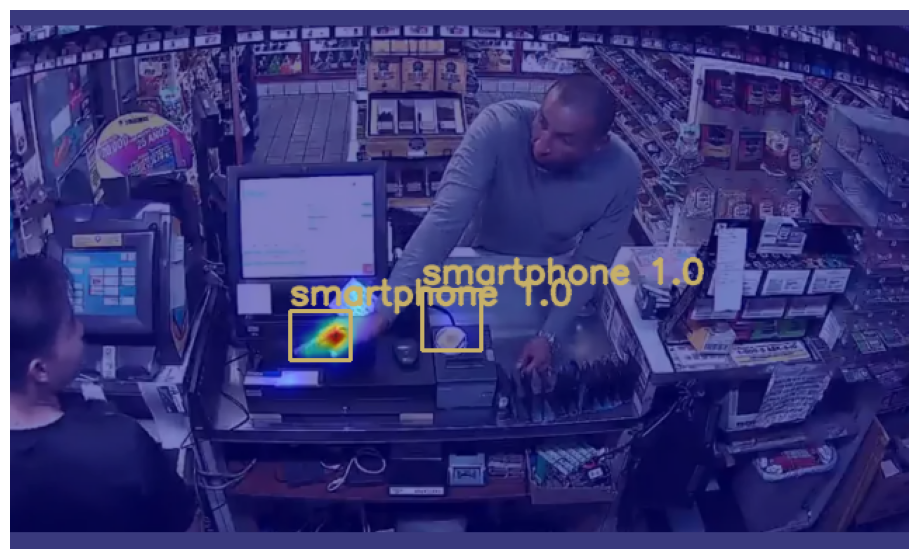

In [31]:
model_egc = yolov8_heatmap(
    weight= model_v8_self_fine_path,
    conf_threshold=0.1,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/armed_robbery_1.png'))

Model summary: 225 layers, 3011238 parameters, 0 gradients, 8.2 GFLOPs


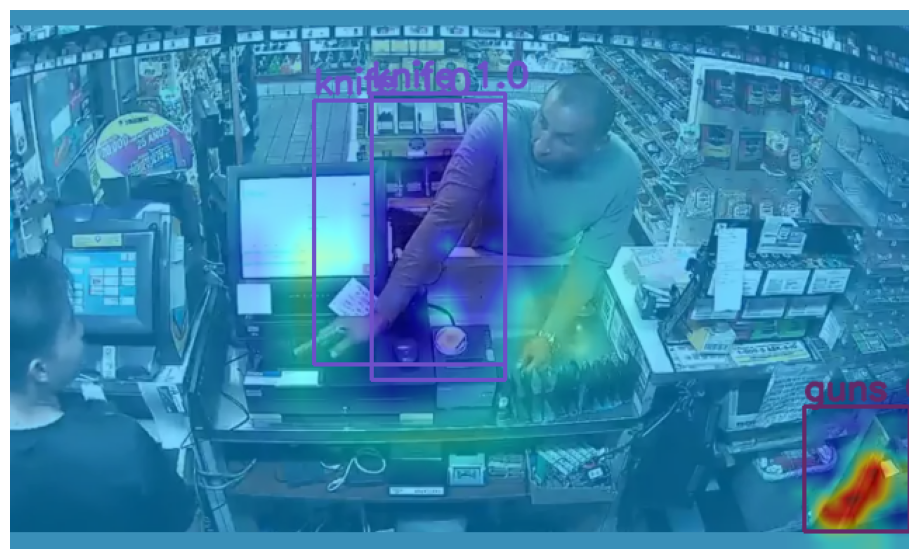

In [32]:
model_egc = yolov8_heatmap(
    weight= 'models/yolov8_pre_trained.pt',
    conf_threshold=0.1,
    method = "EigenGradCAM",
    layer=[10, 12, 14, 16, 18, -3],
    ratio=0.02,
    show_box=True,
    renormalize=False
)
display_images(model_egc('images/armed_robbery_1.png'))

## Robbery 2


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_2.jpg: 512x640 1 person, 1 horse, 1 bottle, 79.7ms
Speed: 2.0ms preprocess, 79.7ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)
Class: person, Confidence: 0.58, Box: (250, 139, 440, 467)
Class: horse, Confidence: 0.36, Box: (479, 64, 630, 404)
Class: bottle, Confidence: 0.27, Box: (61, 25, 111, 137)


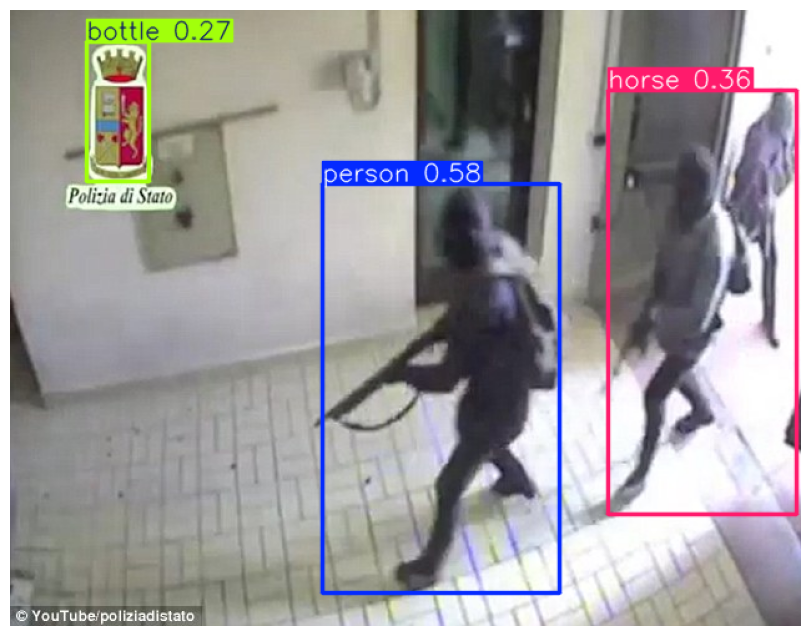


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_2.jpg: 512x640 (no detections), 18.5ms
Speed: 2.0ms preprocess, 18.5ms inference, 0.0ms postprocess per image at shape (1, 3, 512, 640)


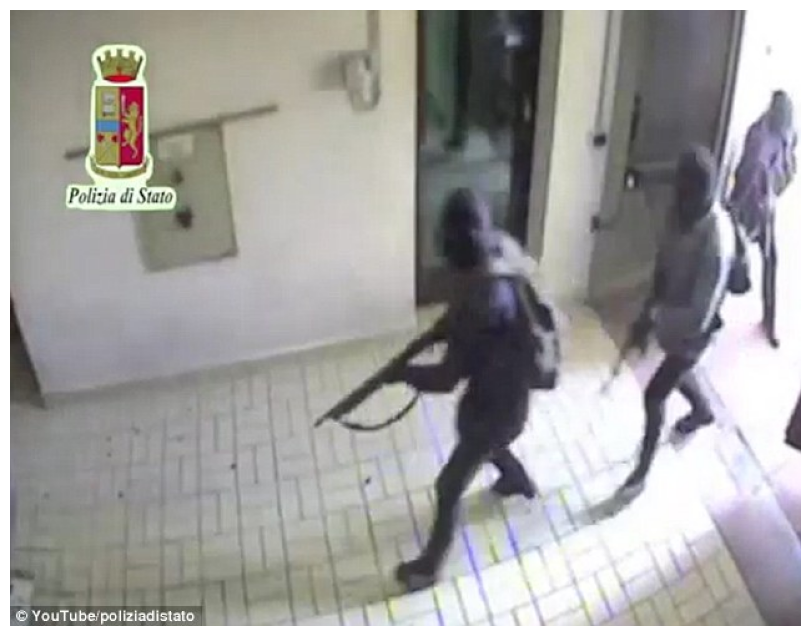


image 1/1 c:\Users\Timo\Desktop\Weapon Detection Model\xAi_Abgabe\images\armed_robbery_2.jpg: 512x640 (no detections), 25.0ms
Speed: 2.0ms preprocess, 25.0ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)


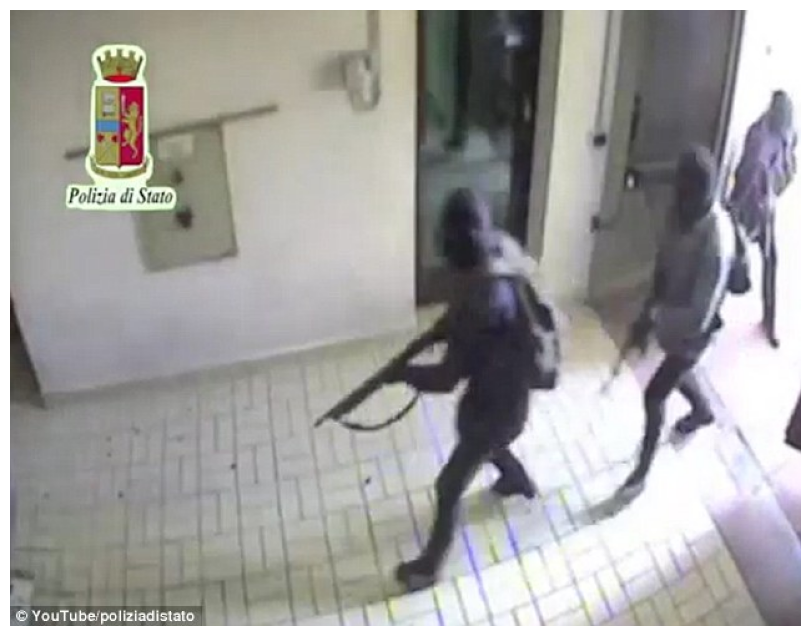

(None, None, None)

In [33]:
detect_objects_plot(model_v8_base, 'images/armed_robbery_2.jpg'), detect_objects_plot(model_v8_fine, 'images/armed_robbery_2.jpg'), detect_objects_plot(model_v8_self_fine, 'images/armed_robbery_2.jpg')

Thanks for reading. For more refer to the Readme in the Repo.